In [3]:
import functools

import torch
from pretorched import gans
from pretorched.gans import BigGAN, biggan, utils
from pretorched import visualizers as vutils

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

### Places365 BigGAN

In [4]:
res = 256
batch_size = 128
pretrained = 'places365'
n_classes = {'places365': 365, 'imagenet': 1000}.get(pretrained)

G = BigGAN(resolution=res, pretrained=pretrained, load_ema=True).to(device)
g = functools.partial(G, embed=True)

z, _ = utils.prepare_z_y(batch_size, G.dim_z, n_classes, device=device, z_var=0.5)
y = torch.randint(G.n_classes, (batch_size,), device=device)

with torch.no_grad():
    G_z = utils.elastic_gan(g, z, y)  # Allows for batches larger than what fits in memory.

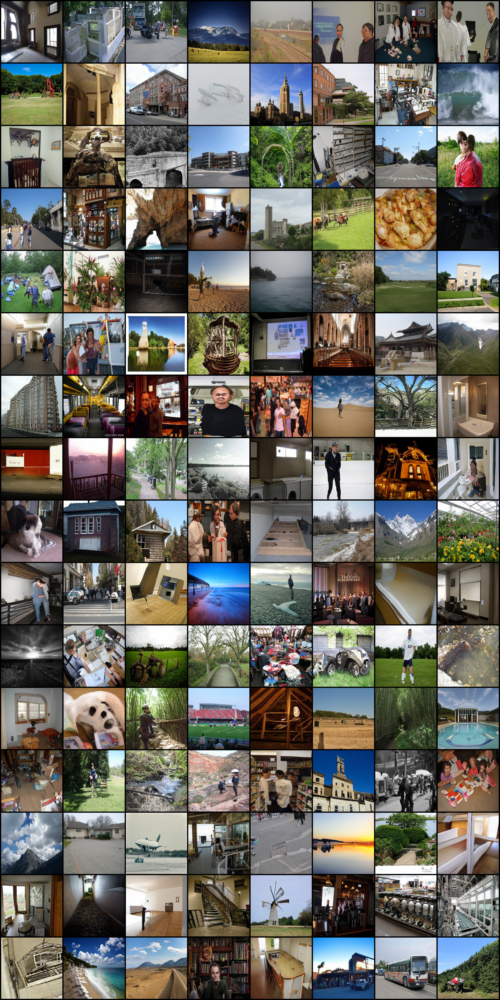

In [5]:
vutils.visualize_samples(G_z)

In [9]:
try:
    del G, g, G_z
except Exception:
    pass
torch.cuda.empty_cache()

### FFHQ StyleGAN

In [17]:
batch_size = 4
G = gans.stylegan(pretrained='ff_hq').to(device)
z = torch.randn(batch_size, 512, device=device)
with torch.no_grad():
    G_z = G(z)

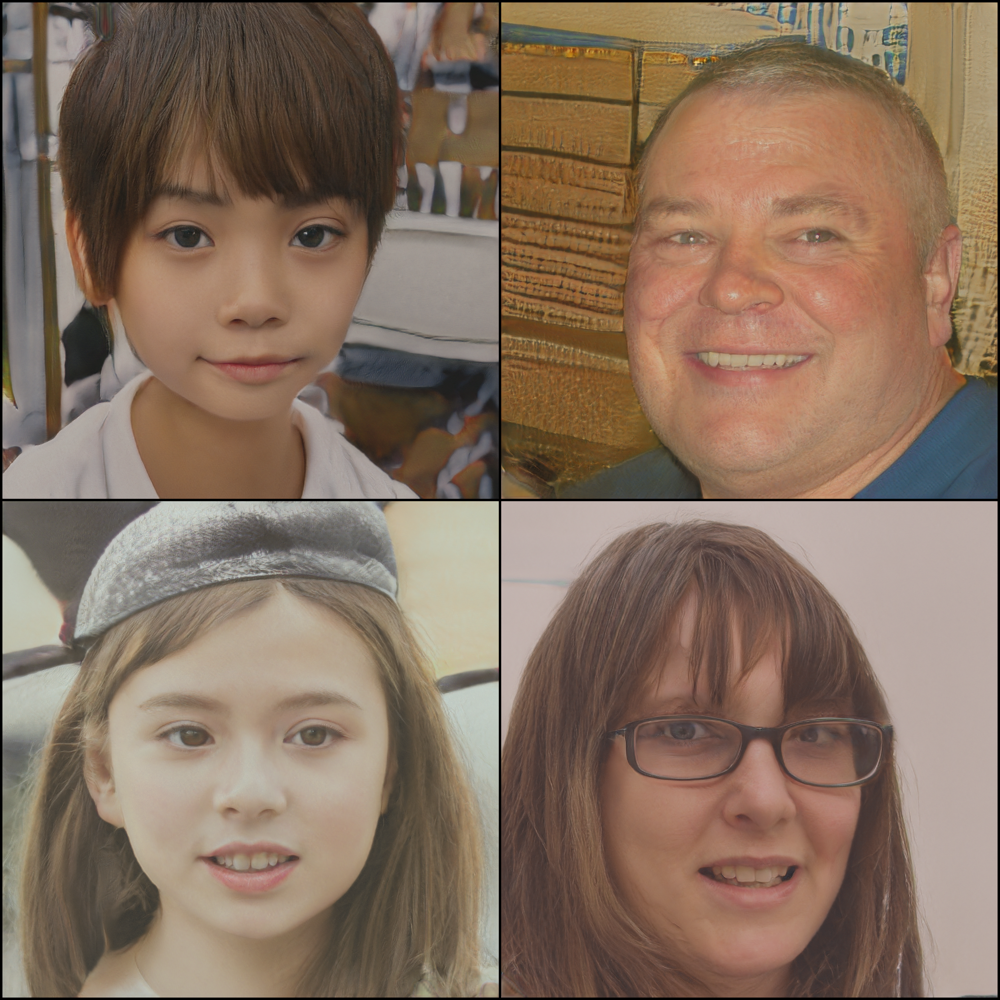

In [19]:
vutils.visualize_samples(G_z, nrow=2)